<h1 align="center">Examining Winter Severity and Hydrological Vernal Window Markers in New Hampshire</h1> 

<h4 align="center">Julia Olson, ESCI895</h4> 

## Introduction

#### Background
   Studies have shown that snowpack and snowmelt patterns are changing and that bud burst, also known as green-up, timing is changing as well, both due to climate change. (1, 2). The time period between snow disappearance and budburst—known as the vernal window (3)—is critical for hydrological processes that impact forest ecosystem health well into the growing season. (3, 2). Thus, identifying different markers of the vernal window is essential for defining hydrological and ecological dynamics in snow-affected ecosystems, especially in light of earlier snowmelt and earlier budburst due to climate change. (2).  
   
   Using historical and future climate model data, this project examined changes in winter severity and hydrological metrics over time, in order to better understand the relationship between winter severity and transitions from winter to spring that occur during the vernal window in two locations in New Hampshire.  


#### Aims 
##### Aim 1: 
Quantify winter severity and analyze whether/how winter severity may be changing over time, in order to understand how snowpack patterns may be changing. 
##### Aim 2:
Identify dates of transition from winter to spring  at both locations for each late winter/spring season. Compare the yearly timing of annual average of peak snow depth, peak soil moisture and peak spring discharge at and between both locations. This helps identify various chronoligical markers within the vernal window time period. 
##### Aim 3: 
Identify lags (length of time) between several dates of transition throughout the vernal window.  
##### Aim 4: 
Use correlational analysis to determine whether timing of transitions and duration of lags varied as a function of winter severity. 

## Methods and Figures

#### Site Description
This study focused on two New Hampshire locations: the area surrounding USGS gauge 01073500, Lamprey River, Newmarket, and the area surrounding USGS gauge 01074520, Pemigewasset River, Woodstock. The two locations were chosen for differences in winter severity. Woodstock is about 100 km north of Newmarket and is no less than 120 kilometers from the coastline with an elevation of 226 m, while Newmarket is located about 12 kilometers from the coast with an elevation of 12 m. These differences in coastal proximity, elevation and latitudinal difference result in more mild winter weather in Newmarket: Newmarket’s average annual minimum temperature range is -23.3 to -20.6 °C, while Woodstock’s is -28.9 to -26.1 °C. (4). These differences in climate are meant to be representative of differences between the White Mountains and Southeastern New Hampshire, and the results of this study may be reflective of how the two regions experience climate change differently.

<div>
<img src='attachment:HDPMap12.20.png' width="700" />

<div> 

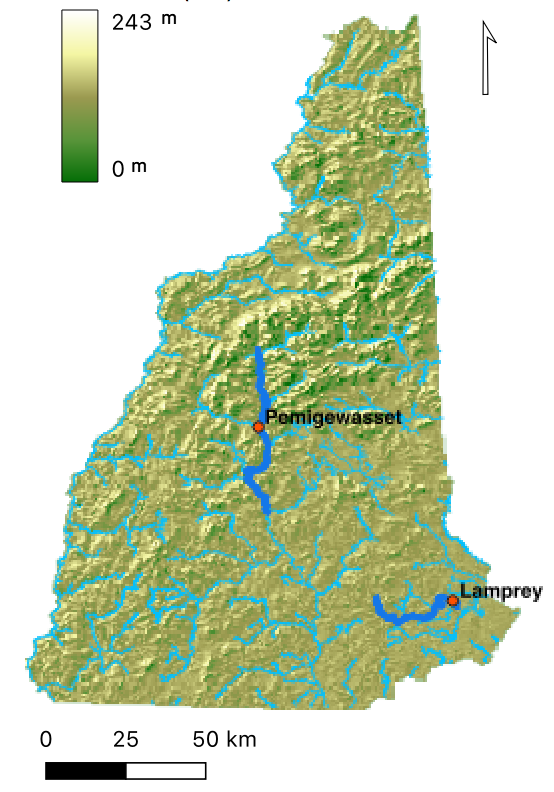

**Fig. 1**  Site map, including a site in Northern New Hampshire and one in Southern New Hampshire. The Northern New Hampshire site lies on the Pemigewasset River; the southern site lies on the Lamprey River. Study rivers are shown in dark blue. 

#### Data
This study used .csv files from LOCA-WBM (localized constructed analogs-water balance model) daily climate and drought data found using CMIP5 (Coupled Model Intercomparison Project Phase 5) simulations (run by Grogan) for the RCP 4.5, scenario for each site for the following: snow depth, temperature, discharge and soil moisture. There are 29 different models for each variable at each site; this study chose to focus analysis on data from one model that predicted comparatively high precipitation and moderate temperature change (ACCESS1-3), one that predicted comparatively moderate precipitation change and high temperature change (HADGEM2-ES), one that predicted comparatively high temperature change and low precipitation change (MIROC_ESM), one that predicted moderate precipitation and temperature change (NorESM1-M), and one that predicted comparatively low precipitation and temperature change (inmcm4), based on Bond (unpublished, 2020). Historical data from this simulation runs from 1980-1-1 through 2005-12-31; future simulated runs from 2006-1-1 to 2099-12-31.

#### Data import, loading, and handling
CMAP data (temperature, soil moisture, snowpack and discharge) for each location were imported, keeping only the selection of models representing a variety of temperature and precipitation scenarios(ACCESS1-3, HADGEM2-ES, NorESM1-M, inmcm4, MIROC_ESM).

The LOCA-WBM daily climate and drought data found using CMIP5 simulations contained missing values or values that needed to be replaced for the years 2005 and 2006, when the model transitioned from a historical simulaion to a future simulation. Any missing values were replaced with NaNs; during correlation analysis, the NaNs were replaced with zeros.   

Constants for freezing temperature and no snow depth were set, based on Grogan. (3)


In [1]:
#%%Import libraries
import pandas as pd
from datetime import datetime
from pprint import pprint
import numpy as np                   
from matplotlib import pyplot as plt 

In [2]:
#%%Import files
fileTL =  'LampreyRiver_tasmax_rcp85_1980-2099_daily.csv'   # Lamprey temp file
fileTP = 'PemigewassetRiver_tasmax_rcp85_1980-2099_daily.csv' #Pemi temp file
fileSPL = 'LampreyRiver_snowPack_rcp85_1980-2099_daily.csv' #lamprey snowpack file
fileSPP = 'PemigewassetRiver_snowPack_rcp85_1980-2099_daily.csv' #pemi snowpack file
fileSMLacc = 'LampreyRiver_soilMoistFrac_ACCESS1-3_rcp85_1980-2099_timeseries.csv' #lamprey soil moisture/ACCESS1-3
fileSMLhad = 'LampreyRiver_soilMoistFrac_HadGEM2-ES_rcp85_1980-2099_timeseries.csv' #lamprey soil moisture/HADGEM2-ES
fileSMLnor =  'LampreyRiver_soilMoistFrac_NorESM1-M_rcp85_1980-2099_timeseries.csv' #lamprey soil moisture/NorESM1-M
fileSMLinm = 'LampreyRiver_soilMoistFrac_inmcm4_rcp85_1980-2099_timeseries.csv' #lamprey soil moisture/inmcm4
fileSMLmir = 'LampreyRiver_soilMoistFrac_MIROC-ESM_rcp85_1980-2099_timeseries.csv' #lamprey soil moisture/MIROC_ESM
fileQLacc = 'LampreyRiver_discharge_ACCESS1-3_rcp85_1980-2099_timeseries.csv' #lamprey discharge/ACCESS1-3
fileQLhad = 'LampreyRiver_discharge_HadGEM2-ES_rcp85_1980-2099_timeseries.csv' #lamprey discharge/HADGEM2-ES
fileQLnor = 'LampreyRiver_discharge_NorESM1-M_rcp85_1980-2099_timeseries.csv' #lamprey discharge/NorESM1-M
fileQLinm = 'LampreyRiver_discharge_inmcm4_rcp85_1980-2099_timeseries.csv' #lamprey discharge/inmcm4
fileQLmir = 'LampreyRiver_discharge_MIROC-ESM_rcp85_1980-2099_timeseries.csv' #lamprey discharge/MIROC_ESM
fileSMPacc = 'PemigewassetRiver_soilMoistFrac_ACCESS1-3_rcp85_1980-2099_timeseries.csv' #pemi soil moisture/ACCESS1-3
fileSMPhad = 'PemigewassetRiver_soilMoistFrac_HadGEM2-ES_rcp85_1980-2099_timeseries.csv' #pemi soil moisture/HADGEM2-ES
fileSMPnor = 'PemigewassetRiver_soilMoistFrac_NorESM1-M_rcp85_1980-2099_timeseries.csv'  #pemi soil moisture/NorESM1-M
fileSMPinm = 'PemigewassetRiver_soilMoistFrac_inmcm4_rcp85_1980-2099_timeseries.csv' #pemi soil moisture/inmcm4
fileSMPmir = 'PemigewassetRiver_soilMoistFrac_MIROC-ESM_rcp85_1980-2099_timeseries.csv' #pemi soil moisture/MIROC_ESM
fileQPacc = 'PemigewassetRiver_discharge_ACCESS1-3_rcp85_1980-2099_timeseries.csv' #pemi discharge/ACCESS1-3
fileQPhad = 'PemigewassetRiver_discharge_HadGEM2-ES_rcp85_1980-2099_timeseries.csv' #pemi discharge/HADGEM2-ES
fileQPnor = 'PemigewassetRiver_discharge_NorESM1-M_rcp85_1980-2099_timeseries.csv' #pemi discharge/NorESM1-M
fileQPinm = 'PemigewassetRiver_discharge_inmcm4_rcp85_1980-2099_timeseries.csv' #pemi discharge/inmcm4
fileQPmir = 'PemigewassetRiver_discharge_MIROC-ESM_rcp85_1980-2099_timeseries.csv' #pemi discharge/MIROC_ESM

In [ ]:
#Lamprey temp
dftl = pd.read_csv(fileTL, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dftl = dftl[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dftl.index = pd.to_datetime(dftl.index)
#Pemi temp
dftp = pd.read_csv(fileTP, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dftp = dftp[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dftp.index = pd.to_datetime(dftp.index)
#Lamprey snowpack
dfspl = pd.read_csv(fileSPL, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfspl = dfspl[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dfspl.index = pd.to_datetime(dfspl.index)
#Pemi snowpack
dfspp = pd.read_csv(fileSPP, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfspp = dfspp[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dfspp.index = pd.to_datetime(dfspp.index)
#Lamprey soil moisture
dfsmlacc = pd.read_csv(fileSMLacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlhad = pd.read_csv(fileSMLhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlnor = pd.read_csv(fileSMLnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlinm = pd.read_csv(fileSMLinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlmir = pd.read_csv(fileSMLmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsoill = pd.concat([dfsmlacc, dfsmlhad, dfsmlnor, dfsmlinm, dfsmlmir], axis=1)
dfsoill.index = pd.to_datetime(dfsoill.index)
#Pemi soil moisture
dfsmpacc = pd.read_csv(fileSMPacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmphad = pd.read_csv(fileSMPhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmpnor = pd.read_csv(fileSMPnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmpinm = pd.read_csv(fileSMPinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmpmir = pd.read_csv(fileSMPmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsoilp = pd.concat([dfsmpacc, dfsmphad, dfsmpnor, dfsmpinm, dfsmpmir], axis=1)
dfsoilp.index = pd.to_datetime(dfsoilp.index)
#Lamprey discharge
dfqlacc = pd.read_csv(fileQLacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlhad = pd.read_csv(fileQLhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlnor = pd.read_csv(fileQLnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlinm = pd.read_csv(fileQLinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlmir = pd.read_csv(fileQLmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfql = pd.concat([dfqlacc, dfqlhad, dfqlnor, dfqlinm, dfqlmir], axis=1)
dfql.index = pd.to_datetime(dfql.index)
#Pemi discharge
dfqpacc = pd.read_csv(fileQPacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqphad = pd.read_csv(fileQPhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqpnor = pd.read_csv(fileQPnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqpinm = pd.read_csv(fileQPinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqpmir = pd.read_csv(fileQPmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqp = pd.concat([dfqpacc, dfqphad, dfqpnor, dfqpinm, dfqpmir], axis=1)
dfqp.index = pd.to_datetime(dfqp.index)

In [ ]:
#Constants
freeze=0
nosnow=.1 

In [ ]:
#%% Load data 
#Lamprey temp
dftl = pd.read_csv(fileTL, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dftl = dftl[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dftl.index = pd.to_datetime(dftl.index)
#Pemi temp
dftp = pd.read_csv(fileTP, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dftp = dftp[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dftp.index = pd.to_datetime(dftp.index)
#Lamprey snowpack
dfspl = pd.read_csv(fileSPL, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfspl = dfspl[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dfspl.index = pd.to_datetime(dfspl.index)
#Pemi snowpack
dfspp = pd.read_csv(fileSPP, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfspp = dfspp[['ACCESS1-3', 'HadGEM2-ES', 'NorESM1-M', 'inmcm4', 'MIROC-ESM']]
dfspp.index = pd.to_datetime(dfspp.index)

In [ ]:
#%%Create Dataframes 
#Lamprey soil moisture
dfsmlacc = pd.read_csv(fileSMLacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlhad = pd.read_csv(fileSMLhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlnor = pd.read_csv(fileSMLnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlinm = pd.read_csv(fileSMLinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmlmir = pd.read_csv(fileSMLmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsoill = pd.concat([dfsmlacc, dfsmlhad, dfsmlnor, dfsmlinm, dfsmlmir], axis=1)
dfsoill.index = pd.to_datetime(dfsoill.index)
#Pemi soil moisture
dfsmpacc = pd.read_csv(fileSMPacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmphad = pd.read_csv(fileSMPhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmpnor = pd.read_csv(fileSMPnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmpinm = pd.read_csv(fileSMPinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsmpmir = pd.read_csv(fileSMPmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfsoilp = pd.concat([dfsmpacc, dfsmphad, dfsmpnor, dfsmpinm, dfsmpmir], axis=1)
dfsoilp.index = pd.to_datetime(dfsoilp.index)
#Lamprey discharge
dfqlacc = pd.read_csv(fileQLacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlhad = pd.read_csv(fileQLhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlnor = pd.read_csv(fileQLnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlinm = pd.read_csv(fileQLinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqlmir = pd.read_csv(fileQLmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfql = pd.concat([dfqlacc, dfqlhad, dfqlnor, dfqlinm, dfqlmir], axis=1)
dfql.index = pd.to_datetime(dfql.index)
#Pemi discharge
dfqpacc = pd.read_csv(fileQPacc, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqphad = pd.read_csv(fileQPhad, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqpnor = pd.read_csv(fileQPnor, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqpinm = pd.read_csv(fileQPinm, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqpmir = pd.read_csv(fileQPmir, delimiter=",", comment='#', header=0,
                 parse_dates= {"date" : ["Year","Month","Day"]}, index_col='date')
dfqp = pd.concat([dfqpacc, dfqphad, dfqpnor, dfqpinm, dfqpmir], axis=1)
dfqp.index = pd.to_datetime(dfqp.index)

In [ ]:
#%%Plot raw data
#Create a plotting function 
def rawdataplot(columntitleacc,columntitlehad, columntitlenor, columntitleinm, 
                columntitlemir, columntitleaccp,columntitlehadp, columntitlenorp, 
                columntitleinmp, columntitlemirp, title, ylabel):
    fig, (ax1, ax2) = plt.subplots(2, 1, sharex=True)
    fig.set_size_inches(15, 8)
    ax1.plot(columntitleacc, linestyle='-',label='ACCESS1-3')
    ax1.plot(columntitlehad, linestyle='-',label='HadGEM2-ES')
    ax1.plot(columntitlenor, linestyle='-',label='NorESM1-M')
    ax1.plot(columntitleinm, linestyle='-',label='inmcm4')
    ax1.plot(columntitlemir, linestyle='-',label='MIROC-ESM')
    ax2.plot(columntitleaccp, linestyle='-',label='ACCESS1-3')
    ax2.plot(columntitlehadp, linestyle='-',label='HadGEM2-ES')
    ax2.plot(columntitlenorp, linestyle='-',label='NorESM1-M')
    ax2.plot(columntitleinmp, linestyle='-',label='inmcm4')
    ax2.plot(columntitlemirp, linestyle='-',label='MIROC-ESM')
    fig.suptitle(title)
    ax1.set_title('Lamprey River')
    ax2.set_title('Pemigewasset River')
    ax2.set_xlabel('Year')
    ax1.set_ylabel(ylabel)
    ax2.set_ylabel(ylabel)
    ax1.legend(loc='best')
    return fig
rawdataplot(dftl['ACCESS1-3'], dftl['HadGEM2-ES'], dftl['NorESM1-M'], 
               dftl['inmcm4'], dftl['MIROC-ESM'],dftp['ACCESS1-3'], dftp['HadGEM2-ES'], dftp['NorESM1-M'], 
                              dftp['inmcm4'], dftp['MIROC-ESM'], 'Temperature', 'temp C')
rawdataplot(dfspl['ACCESS1-3'], dfspl['HadGEM2-ES'], dfspl['NorESM1-M'], 
               dfspl['inmcm4'], dfspl['MIROC-ESM'], dfspp['ACCESS1-3'], dfspp['HadGEM2-ES'], dfspp['NorESM1-M'], 
                              dfspp['inmcm4'], dfspp['MIROC-ESM'],'Snowpack', 'cm')
rawdataplot(dfsoill['ACCESS1-3'], dfsoill['HadGEM2-ES'], dfsoill['NorESM1-M'], 
               dfsoill['inmcm4'], dfsoill['MIROC-ESM'], dfsoilp['ACCESS1-3'], dfsoilp['HadGEM2-ES'], dfsoilp['NorESM1-M'], 
                              dfsoilp['inmcm4'], dfsoilp['MIROC-ESM'], 'Soil Moisture', 'fraction')
rawdataplot(dfql['ACCESS1-3'], dfql['HadGEM2-ES'], dfql['NorESM1-M'], 
               dfql['inmcm4'], dfql['MIROC-ESM'], dfqp['ACCESS1-3'], dfqp['HadGEM2-ES'], dfqp['NorESM1-M'], 
                              dfqp['inmcm4'], dfqp['MIROC-ESM'], 'Discharge', 'cfs')

#### Raw Data Plotted


<div>
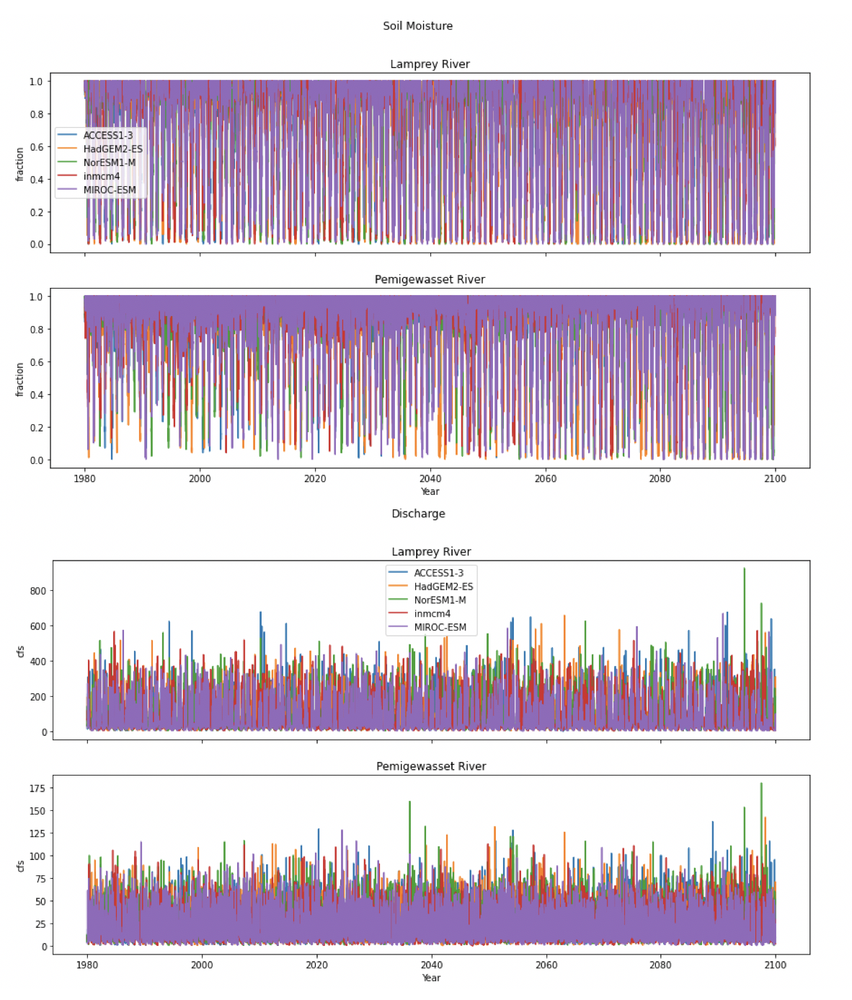

</div>






<div>
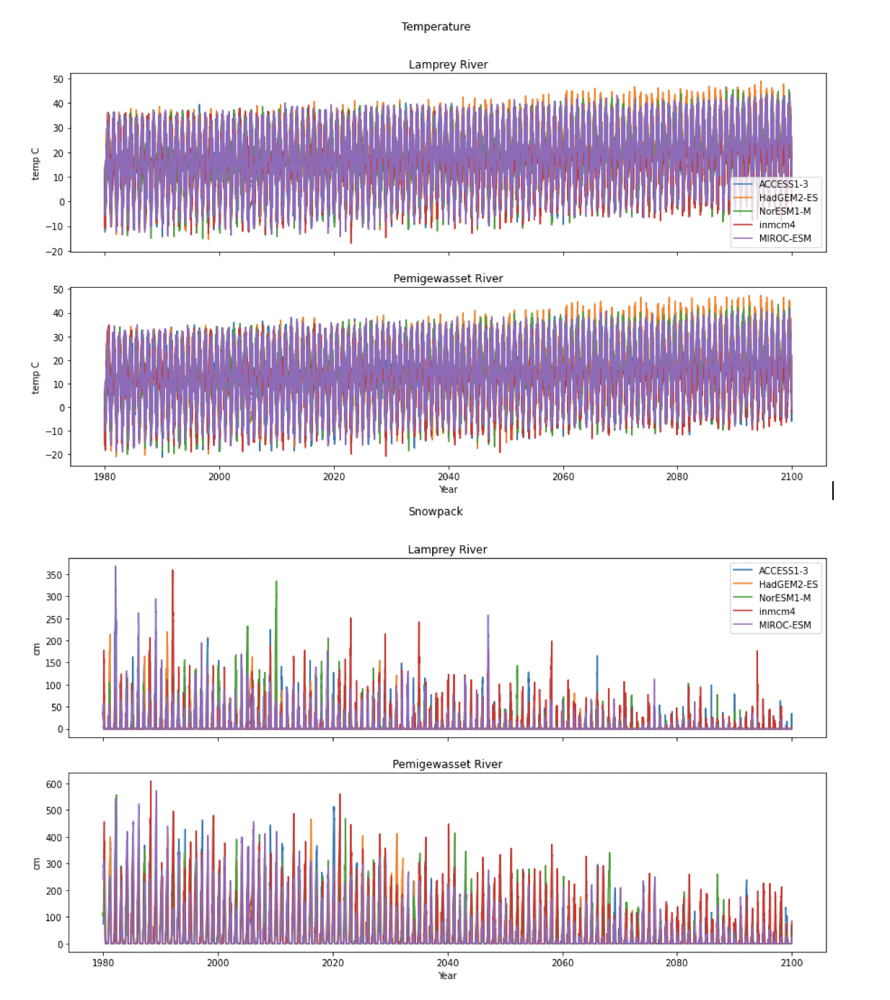

</div>

**Fig. 2**  Raw soil moisture, discharge, temperature and snowpack data over time for each model at both locations. 



#### Prepare a dataframe for analysis
Dataframes, dftransl and dftransp (Lamprey and Pemigewasset, respectively) were created to hold all data analysis series (maximum winter snow depth, date of maximum snow depth, freezing degree days, last freezing day, maximum soil moisture, date of maximum soil moisture, maximum discharge value, and date of maximum discharge) for each model.  

In [ ]:
#%%Create empty data frames to fill with data for each model 
years = [1980,1981,1982,1983,1984,1985,1986,1987,1988,1989,1990,1991,1992,1993,
         1994,1995,1996,1997,1998,1999,2000,2001,2002,2003, 2004, 2006, 2007,
         2008,2009,2010,2011,2012,2013,2014,2015,2016,2017,2018,2019,2020,2021,
         2022,2023,2024,2025,2026,2027,2028,2029,2030,2031,2032,2033,2034,2035,
         2036,2037,2038,2039,2040,2041,2042,2043,2044,2045,2046,2047,2048,2049,
         2050,2051,2052,2053,2054,2055,2056,2057,2058,2059,2060,2061,2062,2063,
         2064,2065,2066,2067,2068,2069,2070,2071,2072,2073,2074,2075,2076,2077,
         2078,2079,2080,2081,2082,2083,2084,2085,2086,2087,2088,2089,2090,2091,
         2092,2093,2094,2095,2096,2097,2098]
column_list = ['maxsnowdepthacc', 'maxsnowdepthdateacc', 'fddacc', 'ttacc', 
               'stacc', 'maxsmacc', 'smdacc', 'maxqacc', 'qdacc', 
               'maxsnowdepthhad','maxsnowdepthdatehad', 'fddhad', 'tthad', 'sthad', 
               'maxsmhad', 'smdhad', 'maxqhad', 'qdhad','maxsnowdepthnor', 'maxsnowdepthdatenor', 
               'fddnor', 'ttnor', 'stnor', 'maxsmnor', 'smdnor', 'maxqnor', 
               'qdnor', 'maxsnowdepthinm', 'maxsnowdepthdateinm', 'fddinm', 'ttinm', 'stinm', 
               'maxsminm', 'smdinm', 'maxqinm', 'qdinm','maxsnowdepthmir', 'maxsnowdepthdatemir',
               'fddmir', 'ttmir', 'stmir', 'maxsmmir', 'smdmir', 'maxqmir', 'qdmir']
dftransl = pd.DataFrame(0, index = years, columns=column_list)
dftransp = pd.DataFrame(0, index = years, columns=column_list)

#### Create a function to plot analysis series over time
A function was created to plot each analysis variable in the dtransl and dfrransp dataframes over time. 

In [ ]:
def timeseriesplot(columntitleacc,columntitlehad, columntitlenor, 
                   columntitleinm, columntitlemir, title, ylabel):
    fig, ax1 = plt.subplots()
    fig.set_size_inches(9, 4)
    ax1.plot(columntitleacc, linestyle='-',label='ACCESS1-3')
    ax1.plot(columntitlehad, linestyle='-',label='HadGEM2-ES')
    ax1.plot(columntitlenor, linestyle='-',label='NorESM1-M')
    ax1.plot(columntitleinm, linestyle='-',label='inmcm4')
    ax1.plot(columntitlemir, linestyle='-',label='MIROC-ESM')
    fig.suptitle(title)
    ax1.set_xlabel('Year')
    ax1.set_ylabel(ylabel)
    ax1.legend(loc='best')
    return fig

#### Winter severity 
  Winter snowiness and coldness were determined to approximate winter severity. Depth and date of peak snow depth were found for each year, to determine how snowy each winter was. The number of cumulative freezing degree days (FDD; days ≥ 0 C) was found to determine how cold each winter was. Together, these metrics represent the severity of a winter. (5). 

The function winterseverity was used to find maximum snowpack depth and date and freezing degree days for each location. A for loop iterated the function for each year, for the winter and spring transition season (January 1 to May 31). Results were stored in the dftrans dataframes for each river and plotted over time. 

In [ ]:
#Winter severity function
def winterseverity(spdf, dft, startdate, enddate, model):
    maxdepth =  spdf.loc[startdate : enddate, model].max() #max snow depth
    maxdepthdate = int(spdf.loc[startdate : enddate, model].idxmax().strftime('%j')) #juliandate of max snow depth
    fdd = sum(dft.loc[startdate : enddate, model]<=freeze)
    return maxdepth, maxdepthdate, fdd
#Iterate for each year
maxsnowdepthaccll = []
maxdepthdateaccll = []
fddaccll = []
maxsnowdepthhadll = []
maxdepthdatehadll = []
fddhadll = []
maxsnowdepthinmll = []
maxdepthdateinmll = []
fddinmll = []
maxsnowdepthnorll = []
maxdepthdatenorll = []
fddnorll = []
maxsnowdepthmirll = []
maxdepthdatemirll = []
fddmirll = []

maxsnowdepthacclp = []
maxdepthdateacclp = []
fddacclp = []
maxsnowdepthhadlp = []
maxdepthdatehadlp = []
fddhadlp = []
maxsnowdepthnorlp = []
maxdepthdatenorlp = []
fddnorlp = []
maxsnowdepthinmlp = []
maxdepthdateinmlp = []
fddinmlp = []
maxsnowdepthmirlp = []
maxdepthdatemirlp = []
fddmirlp = []

In [ ]:
#Run function for each year
#ACCESS 1-3 Model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthacc, maxdepthdateacc, fddacc = winterseverity(dfspl, dftl, 
                                                              startdate, enddate, 'ACCESS1-3')
    maxsnowdepthaccll.append(maxsnowdepthacc)
    maxdepthdateaccll.append(maxdepthdateacc)
    fddaccll.append(fddacc)
dftransl['maxsnowdepthacc'] = maxsnowdepthaccll
dftransl['maxsnowdepthdateacc'] = maxdepthdateaccll
dftransl['fddacc'] = fddaccll
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthacc, maxdepthdateacc, fddacc = winterseverity(dfspp, dftp, 
                                                              startdate, enddate, 'ACCESS1-3')
    maxsnowdepthacclp.append(maxsnowdepthacc)
    maxdepthdateacclp.append(maxdepthdateacc)
    fddacclp.append(fddacc)
dftransp['maxsnowdepthacc'] = maxsnowdepthacclp
dftransp['maxsnowdepthdateacc'] = maxdepthdateacclp
dftransp['fddacc'] = fddacclp 
#HadGEM2-ES Model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthhad, maxdepthdatehad, fddhad = winterseverity(dfspl, dftl, 
                                                              startdate, enddate, 'HadGEM2-ES')
    maxsnowdepthhadll.append(maxsnowdepthhad)
    maxdepthdatehadll.append(maxdepthdatehad)
    fddhadll.append(fddhad)
dftransl['maxsnowdepthhad'] = maxsnowdepthhadll
dftransl['maxsnowdepthdatehad'] = maxdepthdatehadll
dftransl['fddhad'] = fddhadll
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthhad, maxdepthdatehad, fddhad = winterseverity(dfspp, dftp, 
                                                              startdate, enddate, 'HadGEM2-ES')
    maxsnowdepthhadlp.append(maxsnowdepthhad)
    maxdepthdatehadlp.append(maxdepthdatehad)
    fddhadlp.append(fddhad)
dftransp['maxsnowdepthhad'] = maxsnowdepthhadlp
dftransp['maxsnowdepthdatehad'] = maxdepthdatehadlp
dftransp['fddhad'] = fddhadlp 
#'NorESM1-M' model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthnor, maxdepthdatenor, fddnor = winterseverity(dfspl, dftl, 
                                                              startdate, enddate, 'NorESM1-M')
    maxsnowdepthnorll.append(maxsnowdepthnor)
    maxdepthdatenorll.append(maxdepthdatenor)
    fddnorll.append(fddnor)
dftransl['maxsnowdepthnor'] = maxsnowdepthnorll
dftransl['maxsnowdepthdatenor'] = maxdepthdatenorll
dftransl['fddnor'] = fddnorll
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthnor, maxdepthdatenor, fddnor = winterseverity(dfspp, dftp, 
                                                              startdate, enddate, 'NorESM1-M')
    maxsnowdepthnorlp.append(maxsnowdepthnor)
    maxdepthdatenorlp.append(maxdepthdatenor)
    fddnorlp.append(fddnor)
dftransp['maxsnowdepthnor'] = maxsnowdepthnorlp
dftransp['maxsnowdepthdatenor'] = maxdepthdatenorlp
dftransp['fddnor'] = fddnorlp 
#'inmcm4' model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthinm, maxdepthdateinm, fddinm = winterseverity(dfspl, dftl, 
                                                              startdate, enddate, 'inmcm4')
    maxsnowdepthinmll.append(maxsnowdepthinm)
    maxdepthdateinmll.append(maxdepthdateinm)
    fddinmll.append(fddinm)
dftransl['maxsnowdepthinm'] = maxsnowdepthinmll
dftransl['maxsnowdepthdateinm'] = maxdepthdateinmll
dftransl['fddinm'] = fddinmll
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthinm, maxdepthdateinm, fddinm = winterseverity(dfspp, dftp, 
                                                              startdate, enddate, 'inmcm4')
    maxsnowdepthinmlp.append(maxsnowdepthinm)
    maxdepthdateinmlp.append(maxdepthdateinm)
    fddinmlp.append(fddinm)
dftransp['maxsnowdepthinm'] = maxsnowdepthinmlp
dftransp['maxsnowdepthdateinm'] = maxdepthdateinmlp
dftransp['fddinm'] = fddinmlp 
#'MIROC-ESM'model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthmir, maxdepthdatemir, fddmir = winterseverity(dfspl, dftl, 
                                                              startdate, enddate, 'MIROC-ESM')
    maxsnowdepthmirll.append(maxsnowdepthmir)
    maxdepthdatemirll.append(maxdepthdatemir)
    fddmirll.append(fddmir)
dftransl['maxsnowdepthmir'] = maxsnowdepthmirll
dftransl['maxsnowdepthdatemir'] = maxdepthdatemirll
dftransl['fddmir'] = fddmirll
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsnowdepthmir, maxdepthdatemir, fddmir = winterseverity(dfspp, dftp, 
                                                              startdate, enddate, 'MIROC-ESM')
    maxsnowdepthmirlp.append(maxsnowdepthmir)
    maxdepthdatemirlp.append(maxdepthdatemir)
    fddmirlp.append(fddmir)
dftransp['maxsnowdepthmir'] = maxsnowdepthmirlp
dftransp['maxsnowdepthdatemir'] = maxdepthdatemirlp
dftransp['fddmir'] = fddmirlp  

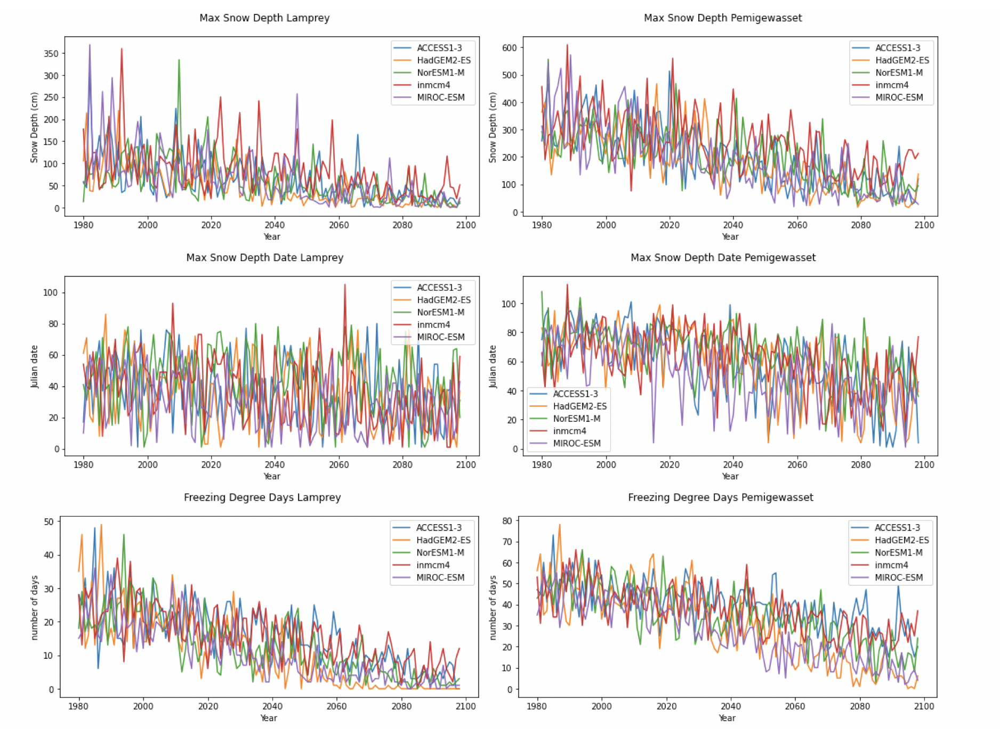


**Fig. 3**  Calculated winter severity variables plotted over time for each model for each location.  



#### Transition dates 
 Next, transition dates were determined for each year. First, early season transition dates were identified. Air temperature was considered to have transitioned to spring when the high air temperature exceeded 0 C, and did not dip below 0 C for the rest of the season. Snow depth was considered to have transitioned on the day of snow disappearance, or when snow depth was less than .1 cm, and did not exceed .1 cm again until the following season. (5, 3). Understanding dates of the last freezing days and snow disappearance helps determines the onset of the transition from winter to spring. 
 Then, hydrological transition dates were identified. The date of peak soil moisture represented the soil moisture transition, and the date of peak baseflow in the river represented river discharge transition. (5). In snow-controlled ecosystems, river discharge and soil moisture peaks represent springtime hydrological transitions.  (5). These transition dates were represented in a time series plotting the day of year each annual transition occurred on the y-axis, over the period of analysis. 

##### First Transition Dates
The function firstransitions was used to find snow transition date and temperature transition date for each location. A for loop iterated the function for each year, for the winter and spring transition season (January 1 to May 31). Results were stored in the dftrans dataframes for each river.

In [ ]:
def firsttransitions(dfsp, dft,  startdate, enddate, model):
    fdd = (dft.loc[startdate : enddate, model]<=freeze) #fdd
    tt = int(fdd.where(fdd==True).dropna().index[-1].strftime('%j')) #T transition date  
    sd = (dfsp.loc[startdate : enddate, model]>=nosnow) #snow on the ground days (snow days)
    st = int(sd.where(sd==True).dropna().index[-1].strftime('%j')) #snow disapearance date (snow transition/st)
    return tt, st
#Iterate for each year
ttaccll = []
staccll = []
tthadll = []
sthadll = []
ttnorll = []
stnorll = []
ttinmll = []
stinmll = []
ttmirll = []
stmirll = []

ttacclp = []
stacclp = []
tthadlp = []
sthadlp = []
ttnorlp = []
stnorlp = []
ttinmlp = []
stinmlp = []
ttmirlp = []
stmirlp = []

In [ ]:
#ACCESS 1-3 Model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    try:
        tt, st = firsttransitions(dfspl, dftl, startdate, enddate, 'ACCESS1-3')
        ttaccll.append(tt)
        staccll.append(st)
    except:
        tt = float('nan')
        st = float('nan')
        ttaccll.append(tt)
        staccll.append(st)
dftransl['ttacc'] = ttaccll
dftransl['stacc'] = staccll 
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    tt, st = firsttransitions(dfspp, dftp, startdate, enddate, 'ACCESS1-3')
    ttacclp.append(tt)
    stacclp.append(st)
dftransp['ttacc'] = ttacclp
dftransp['stacc'] = stacclp
#HADGem2-ES Model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    try:
        tt, st = firsttransitions(dfspl, dftl, startdate, enddate, 'HadGEM2-ES')
        tthadll.append(tt)
        sthadll.append(st)
    except:
        tt=float('nan')
        st=float('nan')
        tthadll.append(tt)
        sthadll.append(st)
dftransl['tthad'] = tthadll
dftransl['sthad'] = sthadll 
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    try:
        tt, st = firsttransitions(dfspp, dftp, startdate, enddate, 'HadGEM2-ES')
        tthadlp.append(tt)
        sthadlp.append(st)
    except:
        tt=float('nan')
        st = float('nan')
        tthadlp.append(tt)
        sthadlp.append(st)
dftransp['tthad'] = tthadlp
dftransp['sthad'] = sthadlp
#'NorESM1-M' model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    try: 
        tt, st = firsttransitions(dfspl, dftl, startdate, enddate, 'NorESM1-M')
        ttnorll.append(tt)
        stnorll.append(st)
    except:
        tt = float('nan')
        st= float('nan')
        ttnorll.append(tt)
        stnorll.append(st)
dftransl['ttnor'] = ttnorll
dftransl['stnor'] = stnorll 
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    tt, st = firsttransitions(dfspp, dftp, startdate, enddate, 'NorESM1-M')
    ttnorlp.append(tt)
    stnorlp.append(st)
dftransp['ttnor'] = ttnorlp
dftransp['stnor'] = stnorlp
#'inmcm4' model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    tt, st = firsttransitions(dfspl, dftl, startdate, enddate, 'inmcm4')
    ttinmll.append(tt)
    stinmll.append(st)
dftransl['ttinm'] = ttinmll
dftransl['stinm'] = stinmll 
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    tt, st = firsttransitions(dfspp, dftp, startdate, enddate, 'inmcm4')
    ttinmlp.append(tt)
    stinmlp.append(st)
dftransp['ttinm'] = ttinmlp
dftransp['stinm'] = stinmlp
#'MIROC-ESM'model
for i,r in dftransl.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    try: 
        tt, st = firsttransitions(dfspl, dftl, startdate, enddate, 'MIROC-ESM')
        ttmirll.append(tt)
        stmirll.append(st)
    except:
        tt = float('nan')
        st = float('nan')
        ttmirll.append(tt)
        stmirll.append(st)
dftransl['ttmir'] = ttmirll
dftransl['stmir'] = stmirll 
for i,r in dftransp.iterrows():
    start = "1, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    tt, st = firsttransitions(dfspp, dftp, startdate, enddate, 'MIROC-ESM')
    ttmirlp.append(tt)
    stmirlp.append(st)
dftransp['ttmir'] = ttmirlp
dftransp['stmir'] = stmirlp

##### Hydrological transition dates 
The function hydtransitions was used to find soil moisture transition date and discharge transition date for each location. A for loop iterated the function for each year, for the winter and spring transition season (January 1 to May 31). Results were stored in the dftrans dataframes for each river.

In [ ]:
#%% Determining hydrological transition dates 
def hydtransitions(dfsoil, dfq, startdate, enddate, model):
    soilslice = ((dfsoil.loc[startdate : enddate, model]).sort_values())<=95.2
    #maxsm = (dfsoil.loc[startdate : enddate, model]).max() #max soil moisture
    smdate = soilslice.where(soilslice==True).dropna().idxmax()
    maxsm = dfsoil.loc[smdate, model]
    smd = int(soilslice.where(soilslice==True).dropna().idxmax().strftime('%j')) #juliandate of max soil moisture
    maxq = dfq.loc[startdate : enddate, model].max() #max discharge
    qd = int(dfq.loc[startdate : enddate, model].idxmax().strftime('%j')) #juliandate of max discharge
    return maxsm, smd, maxq, qd
#Iterate for each year
maxsmaccll = []
smdaccll = []
maxqaccll = []
qdaccll = []
maxsmhadll = []
smdhadll = []
maxqhadll = []
qdhadll = []
maxsmnorll = []
smdnorll = []
maxqnorll = []
qdnorll = []
maxsminmll = []
smdinmll = []
maxqinmll = []
qdinmll = []
maxsmmirll = []
smdmirll = []
maxqmirll = []
qdmirll = []

maxsmacclp = []
smdacclp = []
maxqacclp = []
qdacclp = []
maxsmhadlp = []
smdhadlp = []
maxqhadlp = []
qdhadlp = []
maxsmnorlp = []
smdnorlp = []
maxqnorlp = []
qdnorlp = []
maxsminmlp = []
smdinmlp = []
maxqinmlp = []
qdinmlp = []
maxsmmirlp = []
smdmirlp = []
maxqmirlp = []
qdmirlp = []

In [ ]:
#ACCESS 1-3 Model 
for i,r in dftransl.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmacc, smdacc, maxqacc, qdacc = hydtransitions(dfsoill, dfql, startdate, enddate, 'ACCESS1-3')
    maxsmaccll.append(maxsmacc)
    smdaccll.append(smdacc)
    maxqaccll.append(maxqacc)
    qdaccll.append(qdacc)
dftransl['maxsmacc'] = maxsmaccll
dftransl['smdacc'] = smdaccll
dftransl['maxqacc'] = maxqaccll
dftransl['qdacc'] = qdaccll
for i,r in dftransp.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmacc, smdacc, maxqacc, qdacc = hydtransitions(dfsoilp, dfqp, startdate, enddate, 'ACCESS1-3')
    maxsmacclp.append(maxsmacc)
    smdacclp.append(smdacc)
    maxqacclp.append(maxqacc)
    qdacclp.append(qdacc)
dftransp['maxsmacc'] = maxsmacclp
dftransp['smdacc'] = smdacclp
dftransp['maxqacc'] = maxqacclp
dftransp['qdacc'] = qdacclp
#'HadGEM2-ES' Model 
for i,r in dftransl.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmhad, smdhad, maxqhad, qdhad = hydtransitions(dfsoill, dfql, startdate, enddate, 'HadGEM2-ES')
    maxsmhadll.append(maxsmhad)
    smdhadll.append(smdhad)
    maxqhadll.append(maxqhad)
    qdhadll.append(qdhad)
dftransl['maxsmhad'] = maxsmhadll
dftransl['smdhad'] = smdhadll
dftransl['maxqhad'] = maxqhadll
dftransl['qdhad'] = qdhadll
for i,r in dftransp.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmhad, smdhad, maxqhad, qdhad = hydtransitions(dfsoilp, dfqp, startdate, enddate, 'HadGEM2-ES')
    maxsmhadlp.append(maxsmhad)
    smdhadlp.append(smdhad)
    maxqhadlp.append(maxqhad)
    qdhadlp.append(qdhad)
dftransp['maxsmhad'] = maxsmhadlp
dftransp['smdhad'] = smdhadlp
dftransp['maxqhad'] = maxqhadlp
dftransp['qdhad'] = qdhadlp
#'inmcm4' model Model 
for i,r in dftransl.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsminm, smdinm, maxqinm, qdinm = hydtransitions(dfsoill, dfql, startdate, enddate, 'inmcm4')
    maxsminmll.append(maxsminm)
    smdinmll.append(smdinm)
    maxqinmll.append(maxqinm)
    qdinmll.append(qdinm)
dftransl['maxsminm'] = maxsminmll
dftransl['smdinm'] = smdinmll
dftransl['maxqinm'] = maxqinmll
dftransl['qdinm'] = qdinmll
for i,r in dftransp.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsminm, smdinm, maxqinm, qdinm = hydtransitions(dfsoilp, dfqp, startdate, enddate, 'inmcm4')
    maxsminmlp.append(maxsminm)
    smdinmlp.append(smdinm)
    maxqinmlp.append(maxqinm)
    qdinmlp.append(qdinm)
dftransp['maxsminm'] = maxsminmlp
dftransp['smdinm'] = smdinmlp
dftransp['maxqinm'] = maxqinmlp
dftransp['qdinm'] = qdinmlp
#'NorESM1-M' model
for i,r in dftransl.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmnor, smdnor, maxqnor, qdnor = hydtransitions(dfsoill, dfql, startdate, enddate, 'NorESM1-M')
    maxsmnorll.append(maxsmnor)
    smdnorll.append(smdnor)
    maxqnorll.append(maxqnor)
    qdnorll.append(qdnor)
dftransl['maxsmnor'] = maxsmnorll
dftransl['smdnor'] = smdnorll
dftransl['maxqnor'] = maxqnorll
dftransl['qdnor'] = qdnorll
for i,r in dftransp.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmnor, smdnor, maxqnor, qdnor = hydtransitions(dfsoilp, dfqp, startdate, enddate, 'NorESM1-M')
    maxsmnorlp.append(maxsmnor)
    smdnorlp.append(smdnor)
    maxqnorlp.append(maxqnor)
    qdnorlp.append(qdnor)
dftransp['maxsmnor'] = maxsmnorlp
dftransp['smdnor'] = smdnorlp
dftransp['maxqnor'] = maxqnorlp
dftransp['qdnor'] = qdnorlp
#'MIROC-ESM'model
for i,r in dftransl.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmmir, smdmir, maxqmir, qdmir = hydtransitions(dfsoill, dfql, startdate, enddate, 'MIROC-ESM')
    maxsmmirll.append(maxsmmir)
    smdmirll.append(smdmir)
    maxqmirll.append(maxqmir)
    qdmirll.append(qdmir)
dftransl['maxsmmir'] = maxsmmirll
dftransl['smdmir'] = smdmirll
dftransl['maxqmir'] = maxqmirll
dftransl['qdmir'] = qdmirll
for i,r in dftransp.iterrows():
    start = "2, 1, {}".format(i)
    startdate = datetime.strptime(start, "%m, %d, %Y")
    end = "5, 31, {}".format(i)
    enddate = datetime.strptime(end, "%m, %d, %Y")
    maxsmmir, smdmir, maxqmir, qdmir = hydtransitions(dfsoilp, dfqp, startdate, enddate, 'MIROC-ESM')
    maxsmmirlp.append(maxsmmir)
    smdmirlp.append(smdmir)
    maxqmirlp.append(maxqmir)
    qdmirlp.append(qdmir)
dftransp['maxsmmir'] = maxsmmirlp
dftransp['smdmir'] = smdmirlp
dftransp['maxqmir'] = maxqmirlp
dftransp['qdmir'] = qdmirlp

In [ ]:
#%%Plot variables over time 
#Lamprey
#Winter severity
timeseriesplot(dftransl['maxsnowdepthacc'], dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], 
               dftransl['maxsnowdepthinm'], dftransl['maxsnowdepthmir'],  'Max Snow Depth Lamprey', 'Snow Depth (cm)')
timeseriesplot(dftransl['maxsnowdepthdateacc'], dftransl['maxsnowdepthdatehad'], dftransl['maxsnowdepthdatenor'], 
               dftransl['maxsnowdepthdateinm'], dftransl['maxsnowdepthdatemir'],  'Max Snow Depth Date Lamprey', 'Julian date')
timeseriesplot(dftransl['fddacc'], dftransl['fddhad'], dftransl['fddnor'], 
               dftransl['fddinm'], dftransl['fddmir'],  'Freezing Degree Days Lamprey', 'number of days')
#First transitions 
timeseriesplot(dftransl['ttacc'], dftransl['tthad'], dftransl['ttnor'], 
               dftransl['ttinm'], dftransl['ttmir'],  'Temperature Transition Date Lamprey', 'Julian date')
timeseriesplot(dftransl['stacc'], dftransl['sthad'], dftransl['stnor'], 
               dftransl['stinm'], dftransl['stmir'],  'Snow disappearance date Lamprey', 'Julian date')
#Hydrological transitions 
#timeseriesplot(dftransl['maxsmacc'], dftransl['maxsmhad'], dftransl['maxsmnor'], 
               #dftransl['maxsminm'], dftransl['maxsmmir'],  'Max Snow Moisture Lamprey', 'soil moisture (cm)')
timeseriesplot(dftransl['smdacc'], dftransl['smdhad'], dftransl['smdnor'], 
               dftransl['smdinm'], dftransl['smdmir'],  'Max Soil Moisture Date Lamprey', 'Julian date')
timeseriesplot(dftransl['maxqacc'], dftransl['maxqhad'], dftransl['maxqnor'], 
               dftransl['maxqinm'], dftransl['maxqmir'],  'Max Discharge Lamprey', 'cfs')
timeseriesplot(dftransl['qdacc'], dftransl['qdhad'], dftransl['qdnor'], 
               dftransl['qdinm'], dftransl['qdmir'],  'Max Discharge Date Lamprey', 'Julian date')
#Pemi
#Winter severity
timeseriesplot(dftransp['maxsnowdepthacc'], dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], 
               dftransp['maxsnowdepthinm'], dftransp['maxsnowdepthmir'],  'Max Snow Depth Pemigewasset', 'Snow Depth (cm)')
timeseriesplot(dftransp['maxsnowdepthdateacc'], dftransp['maxsnowdepthdatehad'], dftransp['maxsnowdepthdatenor'], 
               dftransp['maxsnowdepthdateinm'], dftransp['maxsnowdepthdatemir'],  'Max Snow Depth Date Pemigewasset', 'Julian date')
timeseriesplot(dftransp['fddacc'], dftransp['fddhad'], dftransp['fddnor'], 
               dftransp['fddinm'], dftransp['fddmir'],  'Freezing Degree Days Pemigewasset', 'number of days')
#First transitions 
timeseriesplot(dftransp['ttacc'], dftransp['tthad'], dftransp['ttnor'], 
               dftransp['ttinm'], dftransp['ttmir'],  'Temperature Transition Date Pemigewasset', 'Julian date')
timeseriesplot(dftransp['stacc'], dftransp['sthad'], dftransp['stnor'], 
               dftransp['stinm'], dftransp['stmir'],  'Snow disappearance date Pemigewasset', 'Julian date')
#Hydrological transitions 
#timeseriesplot(dftransp['maxsmacc'], dftransp['maxsmhad'], dftransp['maxsmnor'], 
               #dftransp['maxsminm'], dftransp['maxsmmir'],  'Max Snow Moisture Pemigewasset', 'soil moisture (cm)')
timeseriesplot(dftransp['smdacc'], dftransp['smdhad'], dftransp['smdnor'], 
               dftransp['smdinm'], dftransp['smdmir'],  'Max Soil Moisture Date Pemigewasset', 'Julian date')
timeseriesplot(dftransp['maxqacc'], dftransp['maxqhad'], dftransp['maxqnor'], 
               dftransp['maxqinm'], dftransp['maxqmir'],  'Max Discharge Pemigewasset', 'cfs')
timeseriesplot(dftransp['qdacc'], dftransp['qdhad'], dftransp['qdnor'], 
               dftransp['qdinm'], dftransp['qdmir'],  'Max Discharge Date Pemigewasset', 'Julian date')

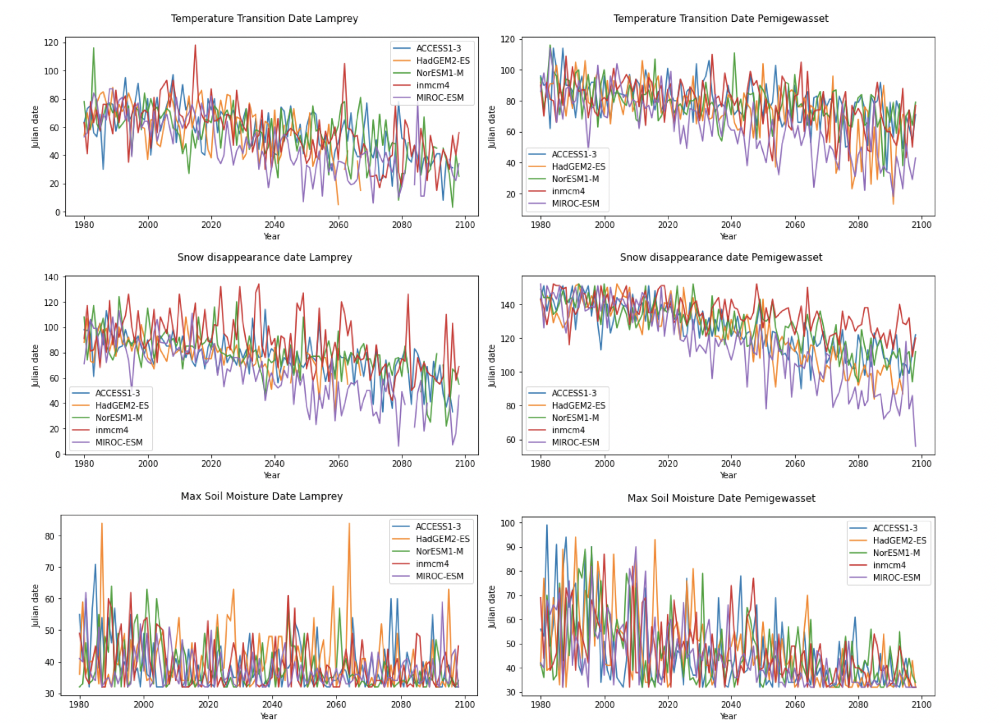

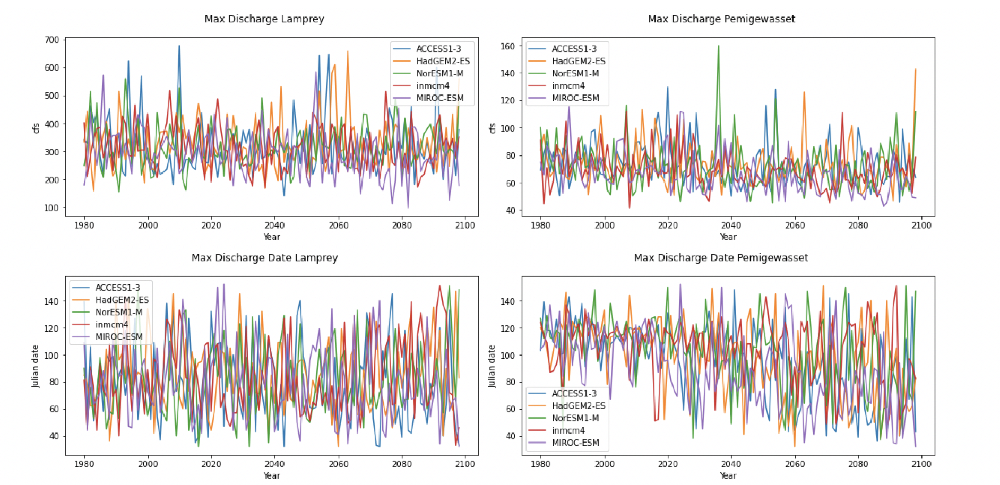

**Fig. 4**  Transition dates for each model at both locations. 



#### Lags
  Next, lags between transition dates were determined for each year. Lags were calculated as the number of days between pairs of transition dates in the same location. (5). Pairs of transition dates for which lags were calculated are represented in Table 1. Lag lengths between transition dates for various variables help determine temporal relationships between these variables. Lag lengths were represented in a time series with lag lengths plotted against year for the length of the analysis period, to visualize how these temporal relationships may change over time. 

**Table 1:** pairs of transition dates for which lags were calculated. 
<div>
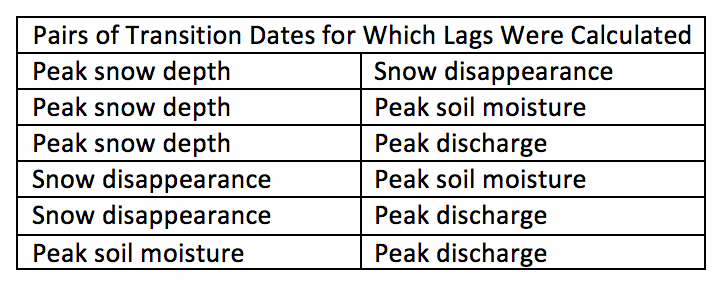

</div>




The function laglength was created to calculate lags. 

In [ ]:
def laglength(latervariable,earliervariable):
    lag = latervariable - earliervariable
    return(lag)

In [ ]:
#Access 1-3 Model 
dftransl['SnowDisappearance_PeakSnowACC'] = laglength(dftransl['stacc'], 
                                                      dftransl['maxsnowdepthdateacc'])
dftransl['PeakSM_PeakSnowACC'] = laglength(dftransl['smdacc'], 
                                        dftransl['maxsnowdepthdateacc'])
dftransl['PeakQ_PeakSnowACC'] = laglength(dftransl['maxqacc'], 
                                        dftransl['maxsnowdepthdateacc'])
dftransl['PeakSM_SnowDisappearanceACC'] = laglength(dftransl['smdacc'], 
                                        dftransl['stacc']) 
dftransl['PeakQ_SnowDisappearanceACC'] = laglength(dftransl['qdacc'], 
                                        dftransl['stacc'])
dftransl['PeakQ_PeakSMACC'] = laglength(dftransl['qdacc'], 
                                        dftransl['smdacc'])
dftransp['SnowDisappearance_PeakSnowACC'] = laglength(dftransp['stacc'], 
                                                      dftransp['maxsnowdepthdateacc'])
dftransp['PeakSM_PeakSnowACC'] = laglength(dftransp['smdacc'], 
                                        dftransp['maxsnowdepthdateacc'])
dftransp['PeakQ_PeakSnowACC'] = laglength(dftransp['maxqacc'], 
                                        dftransp['maxsnowdepthdateacc'])
dftransp['PeakSM_SnowDisappearanceACC'] = laglength(dftransp['smdacc'], 
                                        dftransp['stacc']) 
dftransp['PeakQ_SnowDisappearanceACC'] = laglength(dftransp['qdacc'], 
                                        dftransp['stacc'])
dftransp['PeakQ_PeakSMACC'] = laglength(dftransp['qdacc'], 
                                        dftransp['smdacc'])
#HadGEM2-ES Model 
dftransl['SnowDisappearance_PeakSnowHAD'] = laglength(dftransl['sthad'], 
                                                      dftransl['maxsnowdepthdatehad'])
dftransl['PeakSM_PeakSnowHAD'] = laglength(dftransl['smdhad'], 
                                        dftransl['maxsnowdepthdatehad'])
dftransl['PeakQ_PeakSnowHAD'] = laglength(dftransl['maxqhad'], 
                                        dftransl['maxsnowdepthdatehad'])
dftransl['PeakSM_SnowDisappearanceHAD'] = laglength(dftransl['smdhad'], 
                                        dftransl['sthad']) 
dftransl['PeakQ_SnowDisappearanceHAD'] = laglength(dftransl['qdhad'], 
                                        dftransl['sthad'])
dftransl['PeakQ_PeakSMHAD'] = laglength(dftransl['qdhad'], 
                                        dftransl['smdhad'])
dftransp['SnowDisappearance_PeakSnowHAD'] = laglength(dftransp['sthad'], 
                                                      dftransp['maxsnowdepthdatehad'])
dftransp['PeakSM_PeakSnowHAD'] = laglength(dftransp['smdhad'], 
                                        dftransp['maxsnowdepthdatehad'])
dftransp['PeakQ_PeakSnowHAD'] = laglength(dftransp['maxqhad'], 
                                        dftransp['maxsnowdepthdatehad'])
dftransp['PeakSM_SnowDisappearanceHAD'] = laglength(dftransp['smdhad'], 
                                        dftransp['sthad']) 
dftransp['PeakQ_SnowDisappearanceHAD'] = laglength(dftransp['qdhad'], 
                                        dftransp['sthad'])
dftransp['PeakQ_PeakSMHAD'] = laglength(dftransp['qdhad'], 
                                        dftransp['smdhad'])
#'inmcm4' model
dftransl['SnowDisappearance_PeakSnowINM'] = laglength(dftransl['stinm'], 
                                                      dftransl['maxsnowdepthdateinm'])
dftransl['PeakSM_PeakSnowINM'] = laglength(dftransl['smdinm'], 
                                        dftransl['maxsnowdepthdateinm'])
dftransl['PeakQ_PeakSnowINM'] = laglength(dftransl['maxqinm'], 
                                        dftransl['maxsnowdepthdateinm'])
dftransl['PeakSM_SnowDisappearanceINM'] = laglength(dftransl['smdinm'], 
                                        dftransl['stinm']) 
dftransl['PeakQ_SnowDisappearanceINM'] = laglength(dftransl['qdinm'], 
                                        dftransl['stinm'])
dftransl['PeakQ_PeakSMINM'] = laglength(dftransl['qdinm'], 
                                        dftransl['smdinm'])
dftransp['SnowDisappearance_PeakSnowINM'] = laglength(dftransp['stinm'], 
                                                      dftransp['maxsnowdepthdateinm'])
dftransp['PeakSM_PeakSnowINM'] = laglength(dftransp['smdinm'], 
                                        dftransp['maxsnowdepthdateinm'])
dftransp['PeakQ_PeakSnowINM'] = laglength(dftransp['maxqinm'], 
                                        dftransp['maxsnowdepthdateinm'])
dftransp['PeakSM_SnowDisappearanceINM'] = laglength(dftransp['smdinm'], 
                                        dftransp['stinm']) 
dftransp['PeakQ_SnowDisappearanceINM'] = laglength(dftransp['qdinm'], 
                                        dftransp['stinm'])
dftransp['PeakQ_PeakSMINM'] = laglength(dftransp['qdinm'], 
                                        dftransp['smdinm'])
#'NorESM1-M' model
dftransl['SnowDisappearance_PeakSnowNOR'] = laglength(dftransl['stnor'], 
                                                      dftransl['maxsnowdepthdatenor'])
dftransl['PeakSM_PeakSnowNOR'] = laglength(dftransl['smdnor'], 
                                        dftransl['maxsnowdepthdatenor'])
dftransl['PeakQ_PeakSnowNOR'] = laglength(dftransl['maxqnor'], 
                                        dftransl['maxsnowdepthdatenor'])
dftransl['PeakSM_SnowDisappearanceNOR'] = laglength(dftransl['smdnor'], 
                                        dftransl['stnor']) 
dftransl['PeakQ_SnowDisappearanceNOR'] = laglength(dftransl['qdnor'], 
                                        dftransl['stnor'])
dftransl['PeakQ_PeakSMNOR'] = laglength(dftransl['qdnor'], 
                                        dftransl['smdnor'])
dftransp['SnowDisappearance_PeakSnowNOR'] = laglength(dftransp['stnor'], 
                                                      dftransp['maxsnowdepthdatenor'])
dftransp['PeakSM_PeakSnowNOR'] = laglength(dftransp['smdnor'], 
                                        dftransp['maxsnowdepthdatenor'])
dftransp['PeakQ_PeakSnowNOR'] = laglength(dftransp['maxqnor'], 
                                        dftransp['maxsnowdepthdatenor'])
dftransp['PeakSM_SnowDisappearanceNOR'] = laglength(dftransp['smdnor'], 
                                        dftransp['stnor']) 
dftransp['PeakQ_SnowDisappearanceNOR'] = laglength(dftransp['qdnor'], 
                                        dftransp['stnor'])
dftransp['PeakQ_PeakSMNOR'] = laglength(dftransp['qdnor'], 
                                        dftransp['smdnor'])
#'MIROC-ESM'model
dftransl['SnowDisappearance_PeakSnowMIR'] = laglength(dftransl['stmir'], 
                                                      dftransl['maxsnowdepthdatemir'])
dftransl['PeakSM_PeakSnowMIR'] = laglength(dftransl['smdmir'], 
                                        dftransl['maxsnowdepthdatemir'])
dftransl['PeakQ_PeakSnowMIR'] = laglength(dftransl['maxqmir'], 
                                        dftransl['maxsnowdepthdatemir'])
dftransl['PeakSM_SnowDisappearanceMIR'] = laglength(dftransl['smdmir'], 
                                        dftransl['stmir']) 
dftransl['PeakQ_SnowDisappearanceMIR'] = laglength(dftransl['qdmir'], 
                                        dftransl['stmir'])
dftransl['PeakQ_PeakSMMIR'] = laglength(dftransl['qdmir'], 
                                        dftransl['smdmir'])
dftransp['SnowDisappearance_PeakSnowMIR'] = laglength(dftransp['stmir'], 
                                                      dftransp['maxsnowdepthdatemir'])
dftransp['PeakSM_PeakSnowMIR'] = laglength(dftransp['smdmir'], 
                                        dftransp['maxsnowdepthdatemir'])
dftransp['PeakQ_PeakSnowMIR'] = laglength(dftransp['maxqmir'], 
                                        dftransp['maxsnowdepthdatemir'])
dftransp['PeakSM_SnowDisappearanceMIR'] = laglength(dftransp['smdmir'], 
                                        dftransp['stmir']) 
dftransp['PeakQ_SnowDisappearanceMIR'] = laglength(dftransp['qdmir'], 
                                        dftransp['stmir'])
dftransp['PeakQ_PeakSMMIR'] = laglength(dftransp['qdmir'], 
                                        dftransp['smdmir'])

#### Correlational analysis 
  Finally, it was tested whether timing of transitions and duration of lags varied as a function of winter severity, as represented by snow depth and FDD.  (5). Correlational analysis was performed on number of FDD and duration of lag (number of days) for each lag pair, peak snow depth and duration of lag for each lag pair, FDD and transition date for certain varables, and peak snow depth and transition date for certain variables.  
  The R value for each variable was used to represent strength of relationship between winter severity and the variable. 

The functon plotwinterseverity was created to plot lags and transition dates against the winter severity indicators, FDD and maximum snow depth. 

In [ ]:
#fill na values with 0s 
dftransl = dftransl.fillna(0)
dftransp = dftransp.fillna(0)
#Define functions
def polyfit(variable, wintersevvariable):
    #r value
    correlation = np.corrcoef(variable, wintersevvariable)[0,1]
    return correlation
def plotvswinterseverity(lagacc, laghad, lagnor, laginm, lagmir, fddacc, fddhad, 
                       fddnor, fddinm, fddmir, maxsnowdepthacc, maxsnowdepthhad, 
                       maxsnowdepthnor, maxsnowdepthinm, maxsnowdepthmir, lagtitle, river):
    fig, (ax1, ax2) = plt.subplots(1, 2, sharex = True)
    fig.set_size_inches(13.5, 6)
    lagaccr2 = round(polyfit(lagacc, fddacc,1), 3)
    laghadr2 = round(polyfit(laghad, fddhad,1),3)
    lagnorr2 = round(polyfit(lagnor, fddnor,1), 3) 
    laginmr2 = round(polyfit(laginm, fddinm,1), 3)
    lagmirr2 = round(polyfit(lagmir, fddmir,1), 3)
    polyfit(lagmir, fddmir,1)
    ax1.scatter(lagacc, fddacc,label='ACCESS1-3, r ={}'.format(lagaccr2))
    ax1.scatter(laghad, fddhad,label='HadGEM2-ES, r ={}'.format(laghadr2))
    ax1.scatter(lagnor, fddnor,label='NorESM1-M, r ={}'.format(lagnorr2))
    ax1.scatter(laginm, fddinm,label='inmcm4, r ={}'.format(laginmr2))
    ax1.scatter(lagmir, fddmir,label='MIROC-ESM, r ={}'.format(lagmirr2))
    ax1.set_title('vs. FDD')
    ax1.set_ylabel('Freezing Degree Days')
    lagsaccr2 = round(polyfit(lagacc, maxsnowdepthacc,1), 3)
    lagshadr2 = round(polyfit(laghad, maxsnowdepthhad,1), 3)
    lagsnorr2 = round(polyfit(lagnor, maxsnowdepthnor,1), 3)
    lagsinmr2 = round(polyfit(laginm, maxsnowdepthinm,1), 3)
    lagsmirr2 = round(polyfit(lagmir, maxsnowdepthmir,1), 3)
    ax2.scatter(lagacc, maxsnowdepthacc,label='ACCESS1-3, r ={}'.format(lagsaccr2))
    ax2.scatter(laghad, maxsnowdepthhad,label='HadGEM2-ES, r ={}'.format(lagshadr2))
    ax2.scatter(lagnor, maxsnowdepthnor,label='NorESM1-M, r ={}'.format(lagsnorr2))
    ax2.scatter(laginm, maxsnowdepthinm,label='inmcm4, r ={}'.format(lagsinmr2))
    ax2.scatter(lagmir, maxsnowdepthmir,label='MIROC-ESM, r ={}'.format(lagsmirr2))
    ax2.set_title('vs. Max Snow Depth')
    ax2.set_ylabel('Maximum Snow Depth(cm)')
    fig.suptitle(lagtitle+' vs. Winter Severity,'+river)
    ax1.set_xlabel(lagtitle)
    ax2.set_xlabel(lagtitle)
    ax1.legend(loc='lower left', bbox_to_anchor=(-.1, -.35))
    ax2.legend(loc='lower right', bbox_to_anchor=(1, -.35))
    return fig

The results were plotted. 

In [ ]:
#Peak Snow Depth/Snow Disappearance Lag
plotvswinterseverity(dftransl['SnowDisappearance_PeakSnowACC'], dftransl['SnowDisappearance_PeakSnowHAD'], 
                   dftransl['SnowDisappearance_PeakSnowNOR'], dftransl['SnowDisappearance_PeakSnowINM'], 
                   dftransl['SnowDisappearance_PeakSnowMIR'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Peak Snow Depth/Snow Disappearance Lag', ' Lamprey')
plotvswinterseverity(dftransp['SnowDisappearance_PeakSnowACC'], dftransp['SnowDisappearance_PeakSnowHAD'], 
                   dftransp['SnowDisappearance_PeakSnowNOR'], dftransp['SnowDisappearance_PeakSnowINM'], 
                   dftransp['SnowDisappearance_PeakSnowMIR'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Peak Snow Depth/Snow Disappearance Lag', ' Pemi')
#Peak Snow Depth/Peak Soil Moisture Lag
plotvswinterseverity(dftransl['PeakSM_PeakSnowACC'], dftransl['PeakSM_PeakSnowHAD'], 
                   dftransl['PeakSM_PeakSnowNOR'], dftransl['PeakSM_PeakSnowINM'], 
                   dftransl['PeakSM_PeakSnowMIR'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Peak Snow Depth/Peak Soil Moisture Lag', ' Lamprey')
plotvswinterseverity(dftransp['PeakSM_PeakSnowACC'], dftransp['PeakSM_PeakSnowHAD'], 
                   dftransp['PeakSM_PeakSnowNOR'], dftransp['PeakSM_PeakSnowINM'], 
                   dftransp['PeakSM_PeakSnowMIR'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Peak Snow Depth/Peak Soil Moisture Lag', ' Pemi')
#Peak Snow Depth/Peak Discharge Lag
plotvswinterseverity(dftransl['PeakQ_PeakSnowACC'], dftransl['PeakQ_PeakSnowHAD'], 
                   dftransl['PeakQ_PeakSnowNOR'], dftransl['PeakQ_PeakSnowINM'], 
                   dftransl['PeakQ_PeakSnowMIR'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Peak Snow Depth/Peak Discharge Lag', ' Lamprey')
plotvswinterseverity(dftransp['PeakQ_PeakSnowACC'], dftransp['PeakQ_PeakSnowHAD'], 
                   dftransp['PeakQ_PeakSnowNOR'], dftransp['PeakQ_PeakSnowINM'], 
                   dftransp['PeakQ_PeakSnowMIR'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Peak Snow Depth/Peak Discharge Lag', ' Pemi')
#Snow Disapearrance/Peak Soil Moisture Lag
plotvswinterseverity(dftransl['PeakSM_SnowDisappearanceACC'], dftransl['PeakSM_SnowDisappearanceHAD'], 
                   dftransl['PeakSM_SnowDisappearanceNOR'], dftransl['PeakSM_SnowDisappearanceINM'], 
                   dftransl['PeakSM_SnowDisappearanceMIR'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Snow Disapearrance/Peak Soil Moisture Lag', ' Lamprey')
plotvswinterseverity(dftransp['PeakSM_SnowDisappearanceACC'], dftransp['PeakSM_SnowDisappearanceHAD'], 
                   dftransp['PeakSM_SnowDisappearanceNOR'], dftransp['PeakSM_SnowDisappearanceINM'], 
                   dftransp['PeakSM_SnowDisappearanceMIR'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Snow Disapearrance/Peak Soil Moisture Lag', ' Pemi')
#Snow Disapearrance/Peak Discharge Lag
plotvswinterseverity(dftransl['PeakQ_SnowDisappearanceACC'], dftransl['PeakQ_SnowDisappearanceHAD'], 
                   dftransl['PeakQ_SnowDisappearanceNOR'], dftransl['PeakQ_SnowDisappearanceINM'], 
                   dftransl['PeakQ_SnowDisappearanceMIR'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Snow Disapearrance/Peak Discharge Lag', ' Lamprey')
plotvswinterseverity(dftransp['PeakQ_SnowDisappearanceACC'], dftransp['PeakQ_SnowDisappearanceHAD'], 
                   dftransp['PeakQ_SnowDisappearanceNOR'], dftransp['PeakQ_SnowDisappearanceINM'], 
                   dftransp['PeakQ_SnowDisappearanceMIR'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Snow Disapearrance/Peak Discharge Lag', ' Pemi')
#PeakQ_PeakSM
plotvswinterseverity(dftransl['PeakQ_PeakSMACC'], dftransl['PeakQ_PeakSMHAD'], 
                   dftransl['PeakQ_PeakSMNOR'], dftransl['PeakQ_PeakSMINM'], 
                   dftransl['PeakQ_PeakSMMIR'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Snow Discharge/Peak Soil Moisture Lag', ' Lamprey')
plotvswinterseverity(dftransp['PeakQ_PeakSMACC'], dftransp['PeakQ_PeakSMHAD'], 
                   dftransp['PeakQ_PeakSMNOR'], dftransp['PeakQ_PeakSMINM'], 
                   dftransp['PeakQ_PeakSMMIR'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Peak Discharge/Peak Soil Moisture Lag', ' Pemi')
#Dates
#Snow disappearance date vs. winter severity
plotvswinterseverity(dftransl['stacc'], dftransl['sthad'], 
                   dftransl['stnor'], dftransl['stinm'], 
                   dftransl['stmir'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Snow Disappearance Date', ' Lamprey')
plotvswinterseverity(dftransp['stacc'], dftransp['sthad'], 
                   dftransp['stnor'], dftransp['stinm'], 
                   dftransp['stmir'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Snow Disappearance Date', ' Pemi')
#Max discharge date vs. winter severity
plotvswinterseverity(dftransl['qdacc'], dftransl['qdhad'], 
                   dftransl['qdnor'], dftransl['qdinm'], 
                   dftransl['qdmir'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Max discharge date', ' Lamprey')
plotvswinterseverity(dftransp['qdacc'], dftransp['qdhad'], 
                   dftransp['qdnor'], dftransp['qdinm'], 
                   dftransp['qdmir'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'max discharge date', ' Pemi')
#Peak soil moisture date vs. winter severity 
plotvswinterseverity(dftransl['smdacc'], dftransl['smdhad'], 
                   dftransl['smdnor'], dftransl['smdinm'], 
                   dftransl['smdmir'], dftransl['fddacc'], dftransl['fddhad'], 
                      dftransl['fddnor'], dftransl['fddinm'], dftransl['fddmir'], dftransl['maxsnowdepthacc'], 
                      dftransl['maxsnowdepthhad'], dftransl['maxsnowdepthnor'], dftransl['maxsnowdepthinm'],
                      dftransl['maxsnowdepthmir'], 'Peak Soil Moisture Date', ' Lamprey')
plotvswinterseverity(dftransp['smdacc'], dftransp['smdhad'], 
                   dftransp['smdnor'], dftransp['smdinm'], 
                   dftransp['smdmir'], dftransp['fddacc'], dftransp['fddhad'], 
                      dftransp['fddnor'], dftransp['fddinm'], dftransp['fddmir'], dftransp['maxsnowdepthacc'], 
                      dftransp['maxsnowdepthhad'], dftransp['maxsnowdepthnor'], dftransp['maxsnowdepthinm'],
                      dftransp['maxsnowdepthmir'], 'Peak Soil Moisture Date', ' Pemi')

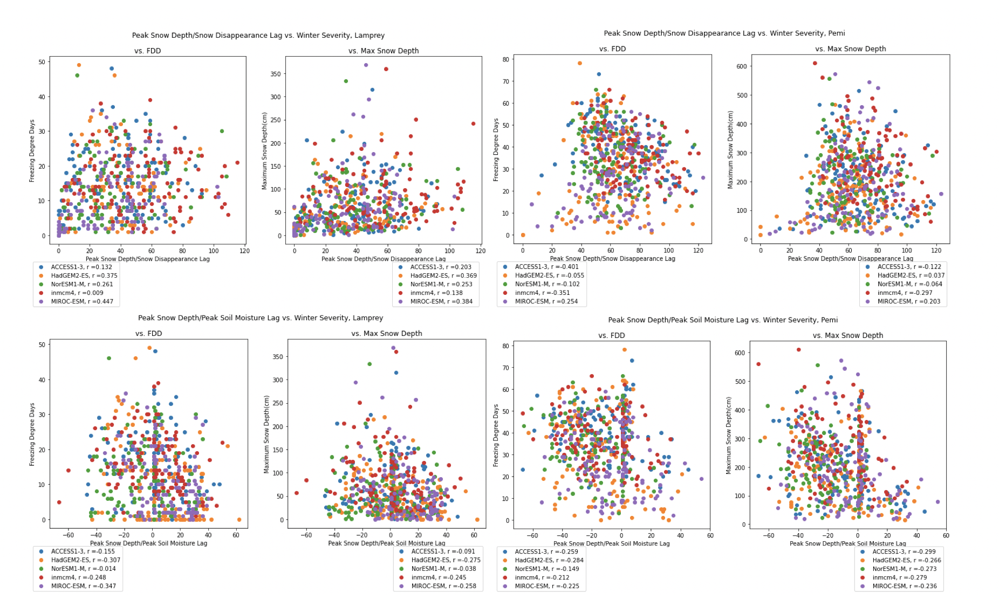

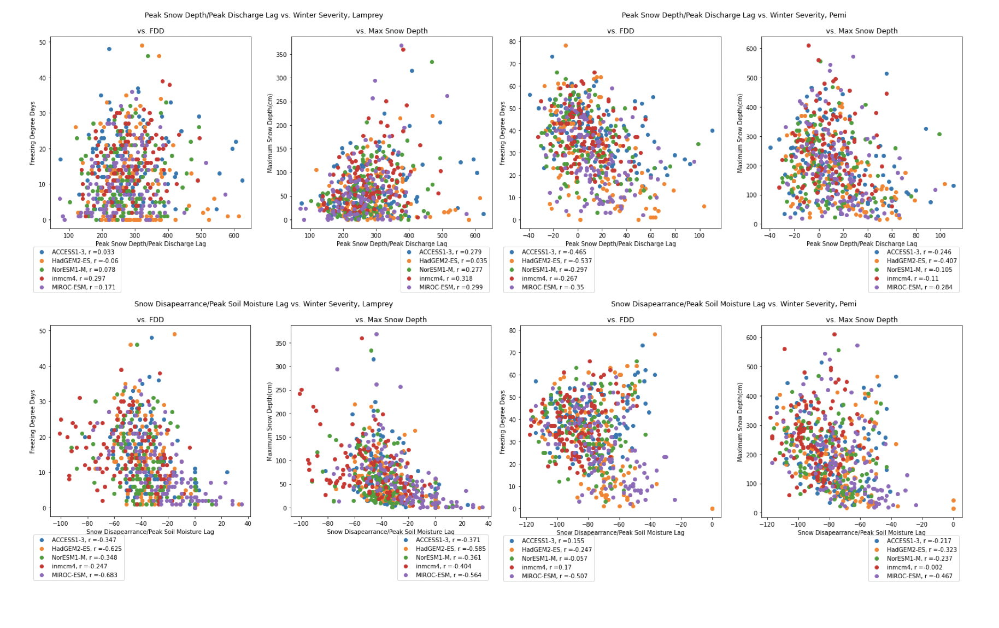

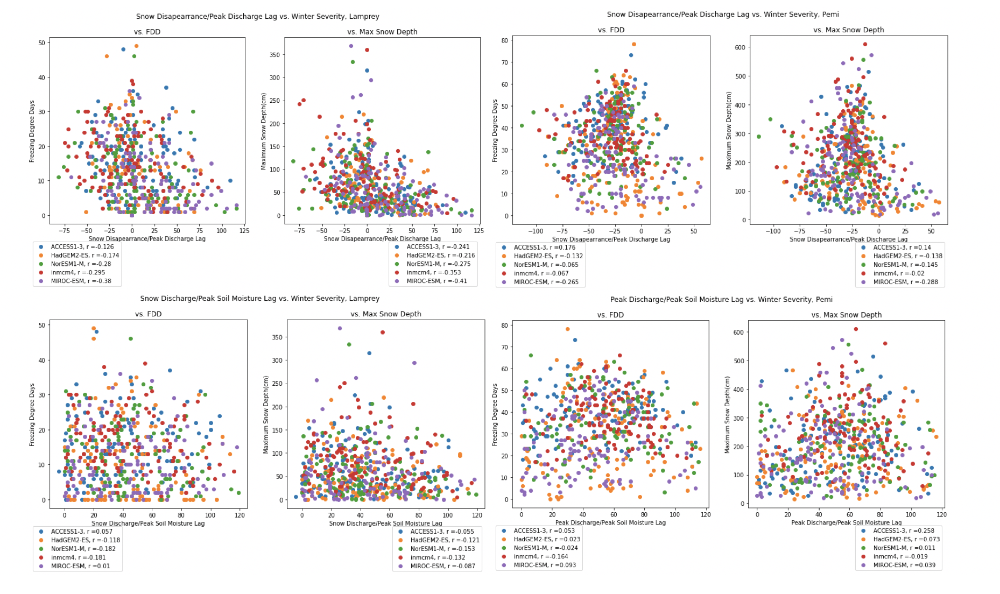

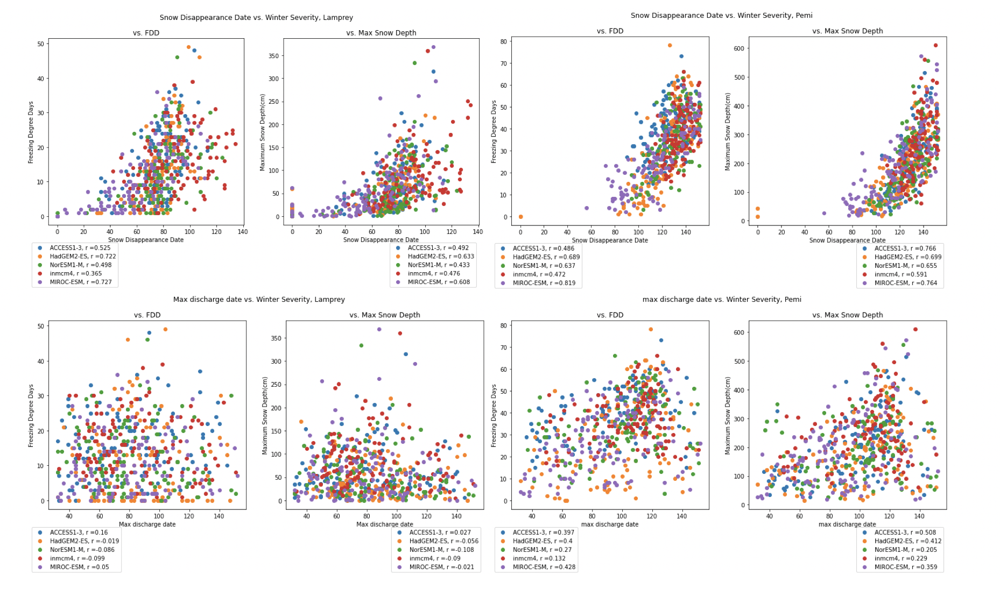

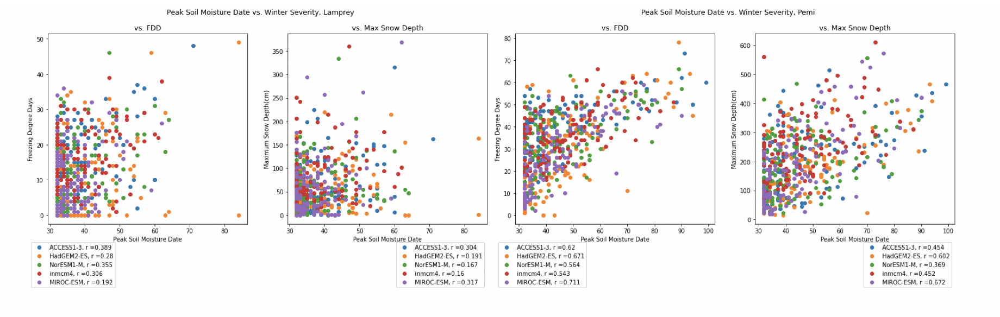

**Figure 5**:  Correlational analysis for each lag and transition date vs. winter severity (freezing degree days and maximum snow depth) for each model at each location. R values are in the legends. 

# Results, discussion and conclusion

#### Results summary

#### Individual variables 
**Snow**
Maximum snow depth decreased over time in both locations, with averages at the Lamprey location decreasing from about 100 cm through the 2030s, to less than 20 cm by the late 2000s, with some models predicting a peak snow depth at less than .1 cm (considered no snow). Average maximum snow depths at the Pemigewasset location decreased from about 300 cm through the late 2030s, to less than 100 cm by the late 2000s (i.e. 2075-2099). 
Earliest maximum snow depth dates became earlier over time at both locations. The change in maximum snow depth date was more drastic at the Pemigewasset location, with max depth dates never occurring before February 9th through the early 2000s, and decreasing to some models showing max snow depth dates of January 1st by the late 2000s. 
Snow disappearance dates also occurred earlier at both locations. At the Lamprey location, in the 1980s, models predicted the presence of snow on the ground through the end of March; by the late 2000s, models that were predicting any winter snowpack had snow disappearing in early to mid-February. The snow disappearance dates showed an even greater shift at the Pemigewasset location: from the 1980s to the late 2000s, snow disappearance dates were predicted to move from late May/early June to mid-March through late April. 

**Temperature**
	Freezing degree days decreased over time at both locations. At the Lamprey location, all models showed at least 10 freezing degree days in the 1980s; by the late 2000s, some models showed no freezing degree days all winter. At the Pemigewasset location, all models showed at least 30 freezing degree days through the 2010s; some models showed less than 10 freezing degree days by the late 2000s. 
	Temperature transitions from winter to spring occurred earlier over time at both locations. The typical transition date at the Lamprey location changed from early March through the early 2000s, to late January by the late 2000s. At the Pemigewasset location, the average transition date occurred in late March through about 2020, shifting to mid- to late February by the late 2000s. 

**Soil Moisture & Discharge**
	At the Lamprey location, there are not clear changes in maximum soil moisture date, maximum discharge date, or maximum discharge date over time. 
	At the Pemigewasset location, there were trends in these variables over time.  The range in peak discharge values increased over time, but overall both peak discharge value and date decreased over time. Maximum soil moisture dates exhibited wide ranges over short time periods, but did decrease over time, from late March to early April through about 2040 to early to mid-March by the late 2000s. 


#### Correlation analysis: winter severity, lag length, and transition dates 
**Transition Dates vs. Winter Severity**
There was moderate to strong positive correlation between both winter severity variables and snow disappearance date at both locations, with very strong positive correlation at the Pemigewasset site. 
There was little to no correlation between peak discharge and peak soil moisture dates and winter severity at the Lamprey location. Conversely, there was moderate to strong positive correlation between peak discharge and peak soil moisture dates and winter severity at the Pemigewasset location. 

**Lag Length vs. Winter Severity** 
Based on r-values for each lag and freezing degree days and maximum snow depth, there was no correlation between the following lags and winter severity at either location: the lag between peak snow depth and snow disappearance date, the lag between peak snow depth and peak soil moisture, the lag between snow disappearance and peak discharge, and the lag between peak discharge and peak soil moisture. 
There was no correlation between the peak snow depth and peak discharge lag and winter severity at the Lamprey location, but there was mild to moderate negative correlation between both freezing degree days and maximum snow depth and this lag at the Pemigewasset location. 
There was moderate to strong correlation between freezing degree days, and mild to moderate correlation between maximum snow depth, and the snow disappearance and peak discharge lag. There was mild to moderate negative correlation between both freezing degree days and maximum snow depth and this lag at the Pemigewasset location. 


#### Discussion and conclusions

    


Overall, winters became less severe and ended earlier in both locations, while hydrological changes varied. Snowpack shrank and snow melted earlier, and winters became warmer and temperature increased above freezing earlier over time at both locations. There were no clear trends in soil moisture or discharge at the Lamprey location, while at the Pemigewasset location, discharge decreased over time and maximum discharge and soil moisture occurred earlier. In general, any changes in variables accelerated around the 2030s at the Lamprey location, and in the 2040s at the Pemigewasset location. 
	There were interesting relationships between winter severity and lags and transition dates at both the Pemigewasset and Lamprey locations, though relationships were not uniform at each location.  At both locations, as winters become less severe over time, it is likely that snow disappearance will occur earlier and earlier, and that the lag between snow disappearance and peak discharge could decrease. Outside of these relationships, at the Lamprey location, winter severity mostly does not correlate to lag length, date of maximum discharge, or peak soil moisture date; it is possible that this is because winter severity and snowfall were so diminished here that the area has transitioned to a hydrological regime similar to today’s Southern, snow-free regions, where winter rain events are hydrological drivers, not snow or freezing degree days.  (3).
At the Pemigewasset location, as winters become less severe, it is possible that the peak discharge date will occur earlier, and likely that peak soil moisture date will occur earlier.  
Further, at the Pemigewassett location it is possible that the lag between maximum snow depth and peak discharge dates will decrease.  
That there is still a moderate to strong relationship between winter severity and hydrological variables at the Pemigewasset location is evidence of the still-persistent influence of snow on hydrology and water availability in that location. As snow’s influence decreases here, it is likely that the hydrological character of this part of Northern New Hampshire could completely change, resulting in cascading changes in ecosystems and water availability. Timing of discharge events and soil moisture availability has implications for species-level phenological events.  
	As the Lamprey location transitions to a little-to-no snow regime, there will be implications not only for hydrological character and spring ecosystem health, but for species that rely on snow cover during the winter. For example, in Southern New Hampshire, mice and voles live under snow during the winter, using the snow for insulation and protection from predators; as snow disappears, these animals will need to adjust winter behaviors or perish. (6).  
	More research is necessary to understand relationship between winter severity and discharge and soil moisture changes; specifically, understanding how winter severity influences baseflow (rather than total discharge) could provide more detailed conclusions. 
	Additionally, this analysis was performed on data based on RCP 4.5 scenarios; understanding implications of an RCP 8.5 scenario is also important. 


## References

1. Choi G, Robinson D A, Kang S 2010 Changing Northern Hemisphere Snow Seasons. Journal of Climate 23, 5305-5310.
2. Richardson, A. D., Keenan, T. F., Migliavacca, M., Ryu, Y., Sonnentag, O., & Toomey, M. (2013). Climate change, phenology, and phenological control of vegetation feedbacks to the climate system. Agricultural and Forest Meteorology, 169, 156-173. https://doi.org/10.1016/j.agrformet.2012.09.012
3. Grogan et al 2020. Environ. Res. Lett. in press https://doi.org/10.1088/1748-9326/abbd00. 
4. USDA Plant Hardiness Zone Map, 2012. Agricultural Research Service, U.S. Department of Agriculture. Accessed from https://planthardiness.ars.usda.gov/
5. Contosta AR, Adolph A, Burchsted D, Burakowski E, Green M, Guerra D, Albert M, Dibb J, Martin M, McDowell WH, Routhier M, Wake C, Whitaker R, Wollheim W. A longer vernal window: the role of winter coldness and snowpack in driving spring transitions and lags. Glob Chang Biol. 2017 Apr;23(4):1610-1625. doi: 10.1111/gcb.13517. Epub 2016 Nov 3. PMID: 27808458.
6. Lamb, Juno. “Nature Notes: Under a Blanket of Snow.” Chocorua Lake Conservancy, Chocorua Lake Conservancy, 29 Feb. 2020, https://www.chocorualake.org/news/2020/2/18/under-a-blanket-of-snow. 

